In [21]:
import os
import time 
import json
import numpy as np
import pandas as pd
from tqdm import tqdm

# from sklearn import tree
from sklearn.model_selection import GridSearchCV
from sklearn.metrics import mean_squared_error, mean_absolute_error, r2_score, explained_variance_score, max_error, median_absolute_error

In [22]:
metrics_unprocessed=["active_dates_and_times",
                     "issue_response_time",
                     "issue_resolution_duration",
                     "issue_age",
                     "change_request_response_time",
                     "change_request_resolution_duration",
                     "change_request_age"
                     ]

metrics_processed=["openrank",
                   "technical_fork",
                   "new_contributors",
                   "inactive_contributors",
                   "bus_factor",
                   "issues_new",
                   "issues_closed",
                   "code_change_lines_add",
                   "code_change_lines_remove",
                   "code_change_lines_sum",
                   "change_requests",
                   "change_requests_accepted",
                   "change_requests_reviews"
                  ]

In [23]:
data_path="../Data/top_300_metrics/"

def is_CHAOSS(met):
    return (met in metrics_unprocessed) or (met in metrics_processed)

def get_table(prj_path):
    time = []
    act_dnt = []

    with open(os.path.join(prj_path, metrics_unprocessed[0] + ".json")) as f:
        data=json.load(f)
        for key, value in data.items():
            time.append(key)
            act_dnt.append(np.average(np.array(value)))

    metric_table = pd.DataFrame({"time":time, "active_dates_and_times":act_dnt})
    for f in os.listdir(prj_path):
        f_path = os.path.join(prj_path, f)
        metric = f[:-5]

        if (metric == metrics_unprocessed[0]) or (not is_CHAOSS(metric)):
            continue

        with open(f_path) as file:
            data = json.load(file)

            if metric in metrics_unprocessed:
                data = data['avg']
                
            if "2021-10-raw" in data:
                data.pop("2021-10-raw")
            file.close()

        metric_table[metric] = metric_table['time'].map(data).fillna(0)

    return metric_table



met_table = []

for organization in tqdm(os.listdir(data_path)):
    org_path = os.path.join(data_path, organization)

    for project in os.listdir(org_path):
        prj_path = os.path.join(org_path, project)
        prj_met_table = get_table(prj_path)
        met_table.append(prj_met_table)
        

        


100%|██████████| 235/235 [00:03<00:00, 70.94it/s]


In [24]:
data = pd.concat(met_table).fillna(0)
data = data.reset_index(drop=True)

data['time'] = pd.to_datetime(data['time'], format="%Y-%m")
data["Time"] = (data["time"].dt.year - data["time"].dt.year.min()) * 12 + data["time"].dt.month
Data = data.drop(columns=['time'])

In [25]:
test_data = data[data['time']>="2023-01"]
train_data = data[data['time']<"2023-01"]

X_train = train_data.drop(columns=["openrank","time"])
y_train = train_data["openrank"]

X_test = test_data.drop(columns=["openrank","time"])
y_test = test_data["openrank"]


print("Data Shape:{}, Train data shape:{}, Test data Shape:{}".format(Data.shape,X_train.shape,X_test.shape))

Data Shape:(21572, 21), Train data shape:(20678, 20), Test data Shape:(894, 20)


In [26]:
X_train.reset_index(drop=True, inplace=True)
X_test.reset_index(drop=True, inplace=True)

y_train.reset_index(drop=True, inplace=True)
y_test.reset_index(drop=True, inplace=True)



In [27]:
from sklearn.cluster import KMeans
from sklearn.preprocessing import StandardScaler

scaler = StandardScaler()
X_train_scaled = scaler.fit_transform(X_train)
X_test_scaled = scaler.transform(X_test)

# print(X_train_scaled)


20678
1577
10601
8500
1577
10601
8500


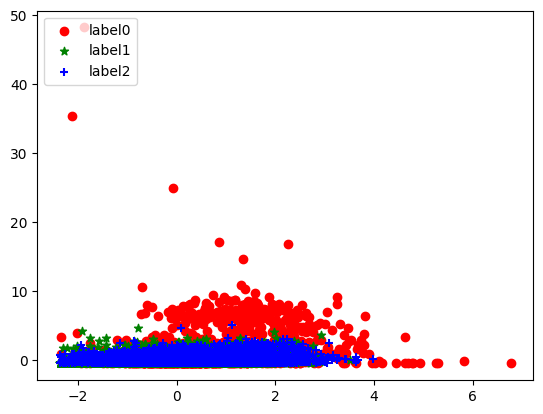

In [29]:
from sklearn.cluster import KMeans
import matplotlib.pyplot as plt

# 初始化KMeans模型
kmeans = KMeans(n_clusters=3, random_state=37)

# 训练模型
kmeans.fit(X_train_scaled)
# 获取聚类标签
y_train_pred = kmeans.labels_

x0 = X_train_scaled[y_train_pred == 0]
x1 = X_train_scaled[y_train_pred == 1]
x2 = X_train_scaled[y_train_pred == 2]
plt.scatter(x0[:, 0], x0[:, 1], c = "red", marker='o', label='label0')
plt.scatter(x1[:, 0], x1[:, 1], c = "green", marker='*', label='label1')
plt.scatter(x2[:, 0], x2[:, 1], c = "blue", marker='+', label='label2')
plt.legend(loc=2)

print(len(y_train_pred))

X_train_c0 = X_train.copy()
X_train_c1 = X_train.copy()
X_train_c2 = X_train.copy()

y_train_0 = y_train.copy()
y_train_1 = y_train.copy()
y_train_2 = y_train.copy()


for i in range(len(y_train_pred)):
    if y_train_pred[i] == 0:
        X_train_c1 = X_train_c1.drop(i)
        X_train_c2 = X_train_c2.drop(i)

        y_train_1 = y_train_1.drop(i)
        y_train_2 = y_train_2.drop(i)
    elif y_train_pred[i] == 1:
        X_train_c0 = X_train_c0.drop(i)
        X_train_c2 = X_train_c2.drop(i)

        y_train_0 = y_train_0.drop(i)
        y_train_2 = y_train_2.drop(i)
    elif y_train_pred[i] == 2:
        X_train_c1 = X_train_c1.drop(i)
        X_train_c0 = X_train_c0.drop(i)

        y_train_1 = y_train_1.drop(i)
        y_train_0 = y_train_0.drop(i)

print(len(X_train_c0))
print(len(X_train_c1))
print(len(X_train_c2))

print(len(y_train_0))
print(len(y_train_1))
print(len(y_train_2))

In [30]:
y_test_pred = kmeans.predict(X_test_scaled)

print(len(y_test_pred))

X_test_c0 = X_test.copy()
X_test_c1 = X_test.copy()
X_test_c2 = X_test.copy()

y_test_0 = y_test.copy()
y_test_1 = y_test.copy()
y_test_2 = y_test.copy()


for i in range(len(y_test_pred)):
    if y_test_pred[i] == 0:
        X_test_c1 = X_test_c1.drop(i)
        X_test_c2 = X_test_c2.drop(i)

        y_test_1 = y_test_1.drop(i)
        y_test_2 = y_test_2.drop(i)
    elif y_test_pred[i] == 1:
        X_test_c0 = X_test_c0.drop(i)
        X_test_c2 = X_test_c2.drop(i)

        y_test_0 = y_test_0.drop(i)
        y_test_2 = y_test_2.drop(i)
    elif y_test_pred[i] == 2:
        X_test_c1 = X_test_c1.drop(i)
        X_test_c0 = X_test_c0.drop(i)

        y_test_1 = y_test_1.drop(i)
        y_test_0 = y_test_0.drop(i)

print(len(X_test_c0))
print(len(X_test_c1))
print(len(X_test_c2))

print(len(y_test_0))
print(len(y_test_1))
print(len(y_test_2))


894
103
18
773
103
18
773


In [31]:
def train_and_evaluate_model(model, params, X_train, y_train, X_test, y_test):
    print('------------------------------')
    print(model)

    start_time = time.time()
    
    # GridSearchCV
    grid = GridSearchCV(model, params, cv=5)
    grid.fit(X_train, y_train)

    end_time = time.time()

    # 计算运行时间
    elapsed_time = end_time - start_time
    print(f'Training and evaluation took {elapsed_time:.2f} seconds')

    # 模型预测
    y_pred = grid.predict(X_test)

    # 计算评估指标
    mse = mean_squared_error(y_test, y_pred)
    rmse = mean_squared_error(y_test, y_pred, squared=False)
    r2 = r2_score(y_test, y_pred)
    evs = explained_variance_score(y_test, y_pred)
    max_err = max_error(y_test, y_pred)
    med_abs_err = median_absolute_error(y_test, y_pred)

    # 保存评估指标到CSV文件
    result = pd.DataFrame({'Metric': ['MSE', 'RMSE', 'R-squared', 'Explained Variance', 'Max Error', 'Median Absolute Error'],
                           'Value': [mse, rmse, r2, evs, max_err, med_abs_err]})
    print(result)
    return result

In [32]:
from sklearn.linear_model import LinearRegression
from sklearn.tree import DecisionTreeRegressor
from sklearn.neighbors import KNeighborsRegressor
from sklearn.linear_model import Ridge
from sklearn.tree import ExtraTreeRegressor
from sklearn.ensemble import RandomForestRegressor
from sklearn.ensemble import BaggingRegressor


In [33]:
models = [
        ('Linear Regression', LinearRegression(), {}),
        ('Decision Tree', DecisionTreeRegressor(), {'max_depth': range(1,10)}),
        ('K-Nearest Neighbors', KNeighborsRegressor(), {'n_neighbors': range(1,10)}),
        ('Ridge Regression', Ridge(), {'alpha': [0.1, 1, 10, 100]}),  # Ridge 正则化参数
        ('Extra Tree Regression', ExtraTreeRegressor(), {'max_depth': range(1, 10)}),  # Extra Tree 最大深度
    ]

In [34]:
results = []  # 存储结果的列表

for name, model, params in models:
        # 模型训练和评估
        result = train_and_evaluate_model(model, params, X_train_c0, y_train_0, X_test_c0, y_test_0)

        # 添加结果到列表
        result['Model'] = name
        results.append(result)

    # 合并结果为一个DataFrame
result_df = pd.concat(results)

------------------------------
LinearRegression()
Training and evaluation took 0.02 seconds
                  Metric         Value
0                    MSE  68134.926840
1                   RMSE    261.026678
2              R-squared      0.776271
3     Explained Variance      0.797896
4              Max Error    633.755280
5  Median Absolute Error    161.142964
------------------------------
DecisionTreeRegressor()


c:\Python312\Lib\site-packages\sklearn\metrics\_regression.py:483: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(


Training and evaluation took 0.49 seconds
                  Metric         Value
0                    MSE  58289.075939
1                   RMSE    241.431307
2              R-squared      0.808601
3     Explained Variance      0.808654
4              Max Error    635.129461
5  Median Absolute Error    156.997131
------------------------------
KNeighborsRegressor()


c:\Python312\Lib\site-packages\sklearn\metrics\_regression.py:483: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(


Training and evaluation took 0.50 seconds
                  Metric          Value
0                    MSE  229880.100757
1                   RMSE     479.458132
2              R-squared       0.245163
3     Explained Variance       0.251291
4              Max Error    1631.430000
5  Median Absolute Error     221.154444
------------------------------
Ridge()
Training and evaluation took 0.06 seconds
                  Metric         Value
0                    MSE  68133.983487
1                   RMSE    261.024871
2              R-squared      0.776274
3     Explained Variance      0.797898
4              Max Error    633.758588
5  Median Absolute Error    161.138317
------------------------------
ExtraTreeRegressor()
Training and evaluation took 0.10 seconds
                  Metric          Value
0                    MSE  102822.650412
1                   RMSE     320.659711
2              R-squared       0.662370
3     Explained Variance       0.670174
4              Max Error     6

c:\Python312\Lib\site-packages\sklearn\metrics\_regression.py:483: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Python312\Lib\site-packages\sklearn\linear_model\_ridge.py:204: LinAlgWarning: Ill-conditioned matrix (rcond=2.44101e-17): result may not be accurate.
  return linalg.solve(A, Xy, assume_a="pos", overwrite_a=True).T
c:\Python312\Lib\site-packages\sklearn\linear_model\_ridge.py:204: LinAlgWarning: Ill-conditioned matrix (rcond=1.28966e-17): result may not be accurate.
  return linalg.solve(A, Xy, assume_a="pos", overwrite_a=True).T
c:\Python312\Lib\site-packages\sklearn\linear_model\_ridge.py:204: LinAlgWarning: Ill-conditioned matrix (rcond=4.88775e-17): result may not be accurate.
  return linalg.solve(A, Xy, assume_a="pos", overwrite_a=True).T
c:\Python312\Lib\site-packages\sklearn\linear_model\_ridge.py:204: LinAlgWarning: Ill-condit

In [45]:
results = []  # 存储结果的列表

for name, model, params in models:
        # 模型训练和评估
        result = train_and_evaluate_model(model, params, X_train_c1, y_train_1, X_test_c1, y_test_1)

        # 添加结果到列表
        result['Model'] = name
        results.append(result)

    # 合并结果为一个DataFrame
result_df = pd.concat(results)

------------------------------
LinearRegression()
Training and evaluation took 0.04 seconds
                  Metric         Value
0                    MSE  25558.181723
1                   RMSE    159.869264
2              R-squared     -0.710866
3     Explained Variance      0.084782
4              Max Error    387.716681
5  Median Absolute Error     59.831343
------------------------------
DecisionTreeRegressor()


c:\Python312\Lib\site-packages\sklearn\metrics\_regression.py:483: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(


Training and evaluation took 2.41 seconds
                  Metric          Value
0                    MSE  143896.987864
1                   RMSE     379.337565
2              R-squared      -8.632471
3     Explained Variance      -6.202239
4              Max Error     870.544000
5  Median Absolute Error      49.737450
------------------------------
KNeighborsRegressor()


c:\Python312\Lib\site-packages\sklearn\metrics\_regression.py:483: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(


Training and evaluation took 0.89 seconds
                  Metric         Value
0                    MSE  20097.284824
1                   RMSE    141.764893
2              R-squared     -0.345313
3     Explained Variance      0.101577
4              Max Error    333.981111
5  Median Absolute Error     82.725000
------------------------------
Ridge()
Training and evaluation took 0.11 seconds
                  Metric         Value
0                    MSE  25522.131793
1                   RMSE    159.756477
2              R-squared     -0.708453
3     Explained Variance      0.085568
4              Max Error    387.475020
5  Median Absolute Error     59.777585
------------------------------
ExtraTreeRegressor()


c:\Python312\Lib\site-packages\sklearn\metrics\_regression.py:483: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Python312\Lib\site-packages\sklearn\linear_model\_ridge.py:204: LinAlgWarning: Ill-conditioned matrix (rcond=7.62919e-17): result may not be accurate.
  return linalg.solve(A, Xy, assume_a="pos", overwrite_a=True).T
c:\Python312\Lib\site-packages\sklearn\metrics\_regression.py:483: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(


Training and evaluation took 0.27 seconds
                  Metric         Value
0                    MSE  31421.187140
1                   RMSE    177.260224
2              R-squared     -1.103336
3     Explained Variance     -0.810878
4              Max Error    382.971250
5  Median Absolute Error    143.016183


c:\Python312\Lib\site-packages\sklearn\metrics\_regression.py:483: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(


In [35]:
models_ = [('Random Forest Regression', RandomForestRegressor(), {'n_estimators': range(1, 101, 10), 'max_depth': range(1, 10)}),  # 随机森林树的数量和最大深度
        ('Bagging Regression', BaggingRegressor(), {'n_estimators': [10, 100, 50], 'max_samples': [0.5, 0.7, 0.9],  'max_features': [0.5, 0.7, 0.9] })
]

In [36]:
results_nm = []  # 存储结果的列表

for name, model, params in models_:
        # 模型训练和评估
        result = train_and_evaluate_model(model, params, X_train_c0,y_train_0, X_test_c0, y_test_0)

        # 添加结果到列表
        result['Model'] = name
        results.append(result)

    # 合并结果为一个DataFrame
result_df_ = pd.concat(results)

------------------------------
RandomForestRegressor()
Training and evaluation took 136.19 seconds
                  Metric         Value
0                    MSE  22075.480222
1                   RMSE    148.578196
2              R-squared      0.927513
3     Explained Variance      0.927620
4              Max Error    384.820501
5  Median Absolute Error     85.420060
------------------------------
BaggingRegressor()


c:\Python312\Lib\site-packages\sklearn\metrics\_regression.py:483: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(


Training and evaluation took 61.74 seconds
                  Metric         Value
0                    MSE  24169.132035
1                   RMSE    155.464247
2              R-squared      0.920638
3     Explained Variance      0.920910
4              Max Error    417.543000
5  Median Absolute Error     87.792000


c:\Python312\Lib\site-packages\sklearn\metrics\_regression.py:483: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(


In [46]:
results_nm = []  # 存储结果的列表

for name, model, params in models_:
        # 模型训练和评估
        result = train_and_evaluate_model(model, params, X_train_c1,y_train_1, X_test_c1, y_test_1)

        # 添加结果到列表
        result['Model'] = name
        results.append(result)

    # 合并结果为一个DataFrame
result_df_ = pd.concat(results)

------------------------------
RandomForestRegressor()
Training and evaluation took 705.75 seconds
                  Metric         Value
0                    MSE  31911.448240
1                   RMSE    178.637757
2              R-squared     -1.136154
3     Explained Variance     -0.401210
4              Max Error    411.062961
5  Median Absolute Error     85.563305
------------------------------
BaggingRegressor()


c:\Python312\Lib\site-packages\sklearn\metrics\_regression.py:483: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(


Training and evaluation took 429.03 seconds
                  Metric         Value
0                    MSE  29563.900812
1                   RMSE    171.941562
2              R-squared     -0.979009
3     Explained Variance     -0.372663
4              Max Error    398.019900
5  Median Absolute Error     69.842050


c:\Python312\Lib\site-packages\sklearn\metrics\_regression.py:483: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(


In [47]:
final_df = pd.concat([result_df, result_df_])

print(final_df)

result_path = "../Result/c1_skl_results.csv"
final_df.to_csv(result_path, index=False)

                   Metric         Value               Model
0                     MSE  25558.181723   Linear Regression
1                    RMSE    159.869264   Linear Regression
2               R-squared     -0.710866   Linear Regression
3      Explained Variance      0.084782   Linear Regression
4               Max Error    387.716681   Linear Regression
..                    ...           ...                 ...
1                    RMSE    171.941562  Bagging Regression
2               R-squared     -0.979009  Bagging Regression
3      Explained Variance     -0.372663  Bagging Regression
4               Max Error    398.019900  Bagging Regression
5   Median Absolute Error     69.842050  Bagging Regression

[72 rows x 3 columns]


In [41]:
import xgboost as xgb

model_xgb = xgb.XGBRegressor()

    # 参数设置
params_xgb = {'colsample_bytree': [0.5, 0.75, 1],
          'learning_rate': [0.01, 0.05, 0.1],
          'max_depth': [3, 6, 9], 
          'alpha': [1, 10],
          'subsample':[0.5, 0.75, 1],
          'min_child_weight':[1, 4],
          'gamma':[0, 0.2, 0.4],
          'reg_alpha':[0.1],
          'reg_lambda':[0.3],
          'scale_pos_weight':[1]}

result_xgb = train_and_evaluate_model(model_xgb, params_xgb, X_train_c0, y_train_0, X_test_c0, y_test_0)


------------------------------
XGBRegressor(base_score=None, booster=None, callbacks=None,
             colsample_bylevel=None, colsample_bynode=None,
             colsample_bytree=None, device=None, early_stopping_rounds=None,
             enable_categorical=False, eval_metric=None, feature_types=None,
             gamma=None, grow_policy=None, importance_type=None,
             interaction_constraints=None, learning_rate=None, max_bin=None,
             max_cat_threshold=None, max_cat_to_onehot=None,
             max_delta_step=None, max_depth=None, max_leaves=None,
             min_child_weight=None, missing=nan, monotone_constraints=None,
             multi_strategy=None, n_estimators=None, n_jobs=None,
             num_parallel_tree=None, random_state=None, ...)
Training and evaluation took 512.99 seconds
                  Metric         Value
0                    MSE  16058.647560
1                   RMSE    126.722719
2              R-squared      0.947270
3     Explained Varian

c:\Python312\Lib\site-packages\sklearn\metrics\_regression.py:483: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(


In [42]:
result_path_xgb = "../Result/c0_xgb_results.csv"
result_xgb.to_csv(result_path_xgb, index=False)

In [43]:
import catboost as ctb

model_ctb = ctb.CatBoostRegressor()

    # 参数设置
params_ctb = {'iterations': [10, 100, 1000],
    'learning_rate':[0.01, 0.05, 0.1, 0.5, 1],
    'l2_leaf_reg':[1, 3, 5],
    'bagging_temperature':[1],
    'random_strength':[1],
    'depth':range(6, 10)}

result_ctb = train_and_evaluate_model(model_ctb, params_ctb, X_train_c0, y_train_0, X_test_c0, y_test_0)


------------------------------
0:	learn: 523.8232831	total: 3.07ms	remaining: 27.7ms
1:	learn: 520.0182282	total: 6.09ms	remaining: 24.4ms
2:	learn: 516.4851488	total: 9.18ms	remaining: 21.4ms
3:	learn: 512.6621455	total: 12.4ms	remaining: 18.6ms
4:	learn: 509.1039810	total: 15.1ms	remaining: 15.1ms
5:	learn: 505.6848658	total: 17.9ms	remaining: 11.9ms
6:	learn: 502.2625251	total: 20.2ms	remaining: 8.66ms
7:	learn: 498.6373590	total: 22.4ms	remaining: 5.59ms
8:	learn: 495.0039052	total: 24.3ms	remaining: 2.7ms
9:	learn: 491.7093994	total: 26.2ms	remaining: 0us
0:	learn: 558.7176879	total: 1.76ms	remaining: 15.9ms
1:	learn: 554.9612745	total: 3.06ms	remaining: 12.2ms
2:	learn: 550.8396722	total: 4.42ms	remaining: 10.3ms
3:	learn: 547.0236621	total: 5.62ms	remaining: 8.43ms
4:	learn: 542.8830992	total: 7.58ms	remaining: 7.58ms
5:	learn: 538.8601684	total: 9.65ms	remaining: 6.43ms
6:	learn: 535.1594852	total: 12.1ms	remaining: 5.2ms
7:	learn: 531.4143103	total: 13.8ms	remaining: 3.46ms
8:

c:\Python312\Lib\site-packages\sklearn\model_selection\_validation.py:542: FitFailedWarning: 
10 fits failed out of a total of 900.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
10 fits failed with the following error:
Traceback (most recent call last):
  File "c:\Python312\Lib\site-packages\sklearn\model_selection\_validation.py", line 890, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "c:\Python312\Lib\site-packages\catboost\core.py", line 5807, in fit
    return self._fit(X, y, cat_features, text_features, embedding_features, None, sample_weight, None, None, None, None, baseline,
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^

43:	learn: 196.3722241	total: 60.1ms	remaining: 1.3s
44:	learn: 195.9692745	total: 61.3ms	remaining: 1.3s
45:	learn: 195.1033967	total: 62.5ms	remaining: 1.29s
46:	learn: 192.6222423	total: 63.7ms	remaining: 1.29s
47:	learn: 190.5297668	total: 65ms	remaining: 1.29s
48:	learn: 189.3476408	total: 66.2ms	remaining: 1.28s
49:	learn: 187.3161268	total: 67.7ms	remaining: 1.29s
50:	learn: 185.5520532	total: 69.1ms	remaining: 1.28s
51:	learn: 183.4882554	total: 70.2ms	remaining: 1.28s
52:	learn: 181.9470705	total: 71.5ms	remaining: 1.28s
53:	learn: 181.6271244	total: 73ms	remaining: 1.28s
54:	learn: 181.1267542	total: 74.3ms	remaining: 1.28s
55:	learn: 180.7856772	total: 76.1ms	remaining: 1.28s
56:	learn: 178.9451579	total: 77.3ms	remaining: 1.28s
57:	learn: 178.6248858	total: 78.7ms	remaining: 1.28s
58:	learn: 176.7553539	total: 79.8ms	remaining: 1.27s
59:	learn: 174.7465855	total: 80.9ms	remaining: 1.27s
60:	learn: 173.3033863	total: 82ms	remaining: 1.26s
61:	learn: 171.5600267	total: 83.1ms

c:\Python312\Lib\site-packages\sklearn\metrics\_regression.py:483: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(


In [44]:
result_path_CTB = "../Result/c0_ctb_results.csv"
result_ctb.to_csv(result_path_CTB, index=False)